# Applie Statistics Project 

Workflow

1. Processing  OK
    • Focus on last 2 or 5 years
    • Consider only the pool where all the zones are present

2. Exploratory Data Analysis OK
    • Treat hours separately (so consider daily time series)
    • Look at similarities within day type, month

3. Functional Data Analysis
    • Smoothing  (we have to do it for day)
    • Functional Principal Component Analysis  
    • K-means

4. Correlation with external variables (Gas price, load and renewable generation forecast)

5. Functional (Auto)Regression models



In [8]:
#import libraries 

import pandas as pd
pd.options.mode.chained_assignment = None

import gzip
import pickle
from io import BytesIO
import plotly.express as px
import matplotlib.pyplot as plt
from math import sqrt
import seaborn as sns
from datetime import datetime
from tqdm.notebook import tqdm
import os
from os.path import join
from ydata_profiling import ProfileReport

import numpy as np
from numpy.polynomial.polynomial import Polynomial

from scipy.stats import gaussian_kde
import statsmodels.api as sm

#GP imputation 
from sklearn.metrics import mean_squared_error
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, DotProduct, RationalQuadratic, ExpSineSquared, Matern
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.model_selection import train_test_split

from itertools import product


#functional data analysis
import skfda
from skfda.exploratory.visualization import FPCAPlot
from skfda.preprocessing.dim_reduction import FPCA
from skfda.representation.basis import (
    BSplineBasis,
    FourierBasis,
    MonomialBasis,

)
from skfda.representation.grid import FDataGrid

In [9]:
#constant definition 

In [10]:
#helper function definition 

#function to convert data and time formats and create a column that contain both values in datetime format
def converti_data_ora(row):
    data_str = str(row['Data'])
    ora_str = str(row['Ora']-1)  # -1 because the range time is from 0 to 23 so ex. hour 1 corresponds to 00:00
    data_ora_str = data_str[:4] + '-' + data_str[4:6] + '-' + data_str[6:] + ' ' + ora_str + ':00:00'
    return datetime.strptime(data_ora_str, '%Y-%m-%d %H:%M:%S')


# Polynomial smoothing
def smooth_series(series, degree=2):
    y = series.values
    mask = ~np.isnan(y)
    coefs = Polynomial.fit(x[mask], y[mask], deg=degree)
    return coefs(x)

# LOESS smoothing 
def apply_loess(series, frac=0.3):
    lowess = sm.nonparametric.lowess # LOESS smoothing
    smoothed_values = lowess(series, series.index, frac=frac, return_sorted=False) # The series index is numeric and represents hours
    return smoothed_values

## Processing and Exploration

### Data Loading

In [11]:
####  using ts_df.pkl.gz 

YEAR = 2023
path = r'C:\Users\bartama\Desktop\PoliMi Stuff\Applied Statistics\Data\dataa\\'
file = 'ts_df.pkl.gz'

with gzip.open(path+file, 'rb') as f:
    loaded_df = pd.read_pickle(f)

# Getting Values from a specific year that can be choose with YEAR constant

loaded_df['Data'] = pd.to_datetime(loaded_df['Data'], format='%Y%m%d')
loaded_df = loaded_df.loc[loaded_df['Data'].dt.year == YEAR,:]

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\bartama\\Desktop\\PoliMi Stuff\\Applied Statistics\\Data\\dataa\\\\ts_df.pkl.gz'

In [12]:
market = 'MGP'
dataset = 'DomandaOfferta'
date_range = pd.date_range(start='2022-01-01', end='2023-12-31')

df_list = []

for date in tqdm(date_range):   #iterate in the range specified before 
    
    date = date.strftime('%Y%m%d') #ex. 2019-01-01 --> 20190101
    file_path = join('data', market +'_'+ dataset, str(date) + market + dataset + '.xml') #file path = data/MGP_DomandaOfferta/20190101DomandaOfferta
    
    if not(os.path.exists(file_path)):      #check correct path existance
        print(f"{file_path} not found")
    else:
        df = pd.read_xml(file_path, xpath=f'./{dataset}')  #read xml file and w in df 
    df_list.append(df)

loaded_df = pd.concat(df_list, ignore_index=True)  #create a unique dataframe 
loaded_df

  0%|          | 0/730 [00:00<?, ?it/s]

,Data,Ora,Mercato,ZonaMercato,PrezzoZonale,Quantita,Prezzo,Tipo
0,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,70000.000,3000.00,OFF
1,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,1.200,1500.00,OFF
2,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,125.000,1000.00,OFF
3,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,101.000,909.32,OFF
4,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,105.000,905.62,OFF
...,...,...,...,...,...,...,...,...
6153398,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID
6153399,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID
6153400,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID
6153401,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID


In [13]:
#saving loaded_df in a pickle file in order to use it in the future without downloading the data again

with open('loaded_df.pickle', 'wb') as f:
    pickle.dump(loaded_df, f)  


In [14]:
# Per Pickle
with open('loaded_df.pickle', 'rb') as f:
    loaded_df = pickle.load(f)

### Exploration 

In [15]:
loaded_df

,Data,Ora,Mercato,ZonaMercato,PrezzoZonale,Quantita,Prezzo,Tipo
0,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,70000.000,3000.00,OFF
1,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,1.200,1500.00,OFF
2,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,125.000,1000.00,OFF
3,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,101.000,909.32,OFF
4,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,105.000,905.62,OFF
...,...,...,...,...,...,...,...,...
6153398,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID
6153399,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID
6153400,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID
6153401,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID


In [16]:
loaded_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6153403 entries, 0 to 6153402
Data columns (total 8 columns):
 #   Column        Dtype  
---  ------        -----  
 0   Data          int64  
 1   Ora           int64  
 2   Mercato       object 
 3   ZonaMercato   object 
 4   PrezzoZonale  float64
 5   Quantita      float64
 6   Prezzo        float64
 7   Tipo          object 
dtypes: float64(3), int64(2), object(3)
memory usage: 375.6+ MB


In [ ]:

PROFILE = ProfileReport(loaded_df, title=" Profiling Report")
PROFILE


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#saving the profile report in a html file in order to visualize it in a more user-friendly way 
PROFILE.to_file("profile_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#load the saved profile report
PROFILE = ProfileReport.load("profile_report.html")

### Processing

In [17]:
loaded_df

,Data,Ora,Mercato,ZonaMercato,PrezzoZonale,Quantita,Prezzo,Tipo
0,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,70000.000,3000.00,OFF
1,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,1.200,1500.00,OFF
2,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,125.000,1000.00,OFF
3,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,101.000,909.32,OFF
4,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,105.000,905.62,OFF
...,...,...,...,...,...,...,...,...
6153398,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID
6153399,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID
6153400,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID
6153401,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID


In [18]:
loaded_df.Ora.value_counts()

Ora
12    277885
15    275484
14    275128
13    274633
11    272485
16    271818
17    267443
10    266593
19    262382
20    262334
18    262015
21    260791
9     258541
22    258038
23    253863
24    250185
8     249648
7     239650
1     236899
3     236107
6     235891
2     235352
5     235077
4     234618
25       543
Name: count, dtype: int64

In [19]:
# delete rows where hour is 25
loaded_df = loaded_df[loaded_df.Ora != 25]

In [20]:
#select only the pool where all zanes are present so the situation in which all zones collaborate in a unique market 

loaded_df = loaded_df.loc[loaded_df.ZonaMercato=='CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CORS;FRAN;GREC;SLOV;SVIZ;MALT;COUP;MONT;',:]


In [21]:
loaded_df['Data'] = pd.to_datetime(loaded_df['Data'], format='%Y%m%d').dt.strftime('%Y-%m-%d')
loaded_df['Ora'] = (loaded_df['Ora'] - 1).astype(str).str.zfill(2) + ':00:00'

loaded_df['DataOra'] = pd.to_datetime(loaded_df['Data'] + ' ' + loaded_df['Ora'])

In [22]:
# rename columns to English

column_mapping = {'Data': 'Day', 'Ora': 'Hour',"Mercato":"Market", 'ZonaMercato': 'MarketArea', 'PrezzoZonale': 'ZonalPrice', 'Quantita': 'Quantity', 'Prezzo': 'Price', 'Tipo': 'Type', "DataOra": "Date"}


loaded_df.rename(columns=column_mapping, inplace=True)

In [23]:
# looking for duplicates rows
duplicate_row = loaded_df[loaded_df.duplicated()]
duplicate_row.value_counts()


Series([], Name: count, dtype: int64)

In [24]:
loaded_df

,Day,Hour,Market,MarketArea,ZonalPrice,Quantity,Price,Type,Date
2525,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,70000.000,3000.00,OFF,2022-01-01 07:00:00
2526,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,1.200,1500.00,OFF,2022-01-01 07:00:00
2527,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,195.000,1000.00,OFF,2022-01-01 07:00:00
2528,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,101.000,909.32,OFF,2022-01-01 07:00:00
2529,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,105.000,905.62,OFF,2022-01-01 07:00:00
...,...,...,...,...,...,...,...,...,...
6153398,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID,2023-12-31 23:00:00
6153399,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID,2023-12-31 23:00:00
6153400,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID,2023-12-31 23:00:00
6153401,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID,2023-12-31 23:00:00


In [25]:
# saved datafram preprocess_df in a pickle file in order to use it in the future without reprocessing the data
with open('preprocess_df.pickle', 'wb') as f:
    pickle.dump(loaded_df, f)  

In [26]:
#load the saved preprocess_df
with open('preprocess_df.pickle', 'rb') as f:
    loaded_df = pickle.load(f)

In [27]:
columns_wanted = ['Date', 'ZonalPrice', 'Quantity','Price']

## BID

In [28]:


bid = loaded_df.loc[loaded_df.Type == "BID",columns_wanted]
bid_df = bid.copy()
bid.Price = bid.Price *-1 ## for bid prices, take the negative of it
bid = bid.sort_values(by=['Price']).reset_index(drop = True) # sort in ascending way
bid['Cumulative Quantity'] = bid.Quantity.cumsum()


ask = loaded_df.loc[loaded_df.Type == "OFF",columns_wanted]
ask_df = ask.copy()
ask = ask.sort_values(by=['Price']).reset_index(drop = True)
ask['Cumulative Quantity'] = ask.Quantity.cumsum()

In [29]:
#salva bid_df e ask_df in un file pickle per utilizzarli in futuro senza doverli ricalcolare
with open('bid_df.pickle', 'wb') as f:
    pickle.dump(bid_df, f)

with open('ask_df.pickle', 'wb') as f:
    pickle.dump(ask_df, f)

In [ ]:
#load the saved preprocess_df
with open('bid_df.pickle', 'rb') as f:
    bid_df = pickle.load(f)

#load the saved preprocess_df
with open('ask_df.pickle', 'rb') as f:
    ask_df = pickle.load(f)

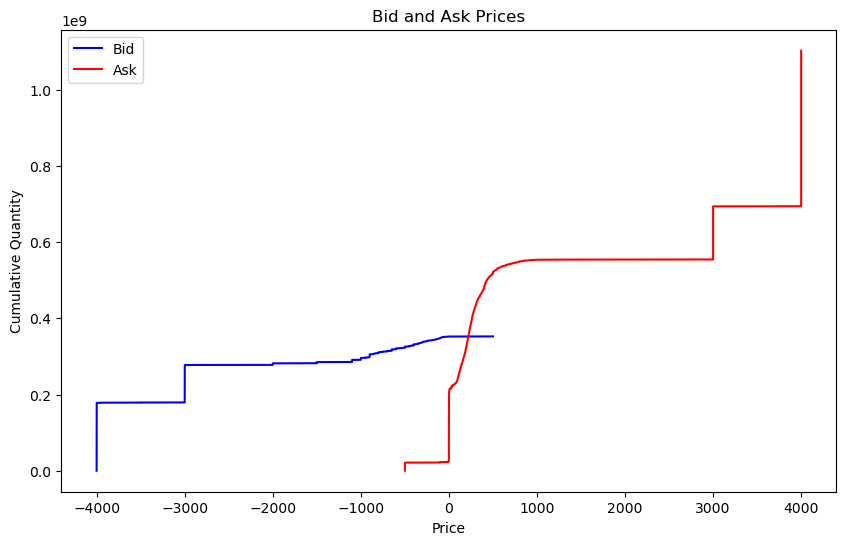

In [30]:
#plot similarities between bid and ask prices
plt.figure(figsize=(10,6))
plt.plot(bid['Price'], bid['Cumulative Quantity'], label='Bid', color='blue')
plt.plot(ask['Price'], ask['Cumulative Quantity'], label='Ask', color='red')
plt.xlabel('Price')
plt.ylabel('Cumulative Quantity')
plt.title('Bid and Ask Prices')
plt.legend()
plt.show()

### BID

In [31]:
bid_df

,Date,ZonalPrice,Quantity,Price
2840,2022-01-01 07:00:00,99.99,18775.156,3000.00
2841,2022-01-01 07:00:00,99.99,7.114,2999.00
2842,2022-01-01 07:00:00,99.99,2.526,2000.00
2843,2022-01-01 07:00:00,99.99,162.000,1000.00
2844,2022-01-01 07:00:00,99.99,267.513,800.00
...,...,...,...,...
6153398,2023-12-31 23:00:00,106.12,0.007,0.00
6153399,2023-12-31 23:00:00,106.12,50.000,-0.27
6153400,2023-12-31 23:00:00,106.12,9.000,-3.01
6153401,2023-12-31 23:00:00,106.12,54.000,-100.00


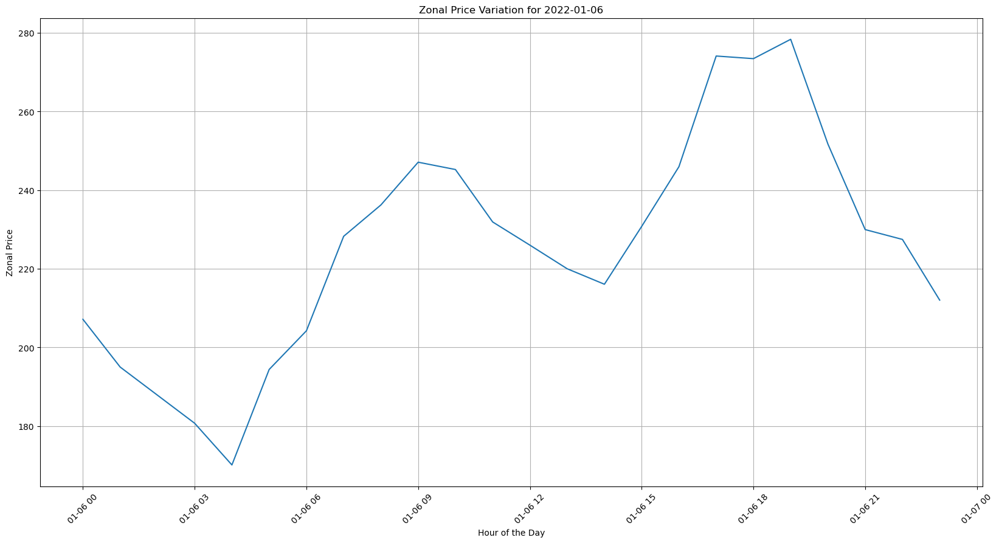

In [32]:

target_date = '2022-01-06'

target_day_data = bid_df[bid_df['Date'].dt.date == pd.to_datetime(target_date).date()]

plt.figure(figsize=(20, 10))
plt.plot(target_day_data['Date'], target_day_data['ZonalPrice'])
plt.xlabel('Hour of the Day')
plt.ylabel('Zonal Price')
plt.title(f'Zonal Price Variation for {target_date}')
plt.grid(True)
plt.xticks(rotation=45) 
plt.show()





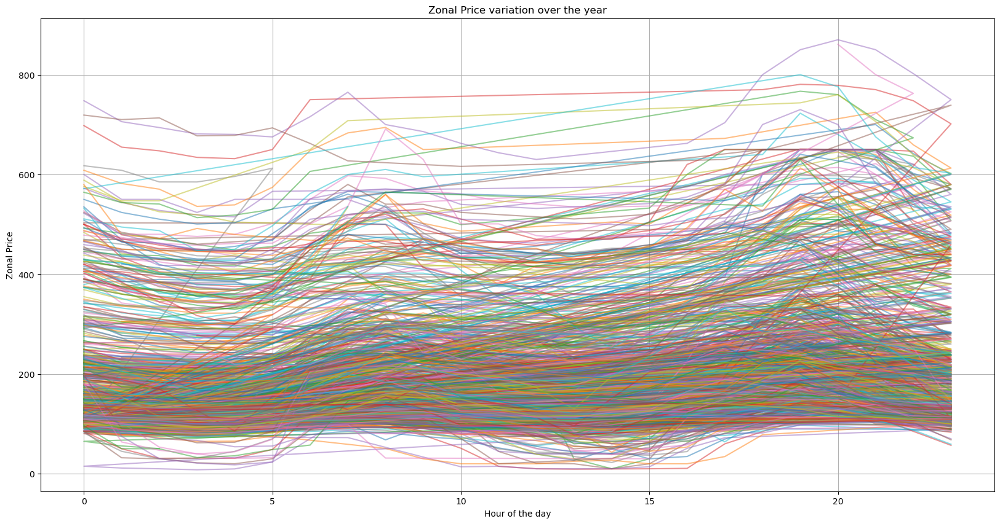

In [33]:
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

plt.figure(figsize=(20, 10))

for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    plt.plot(daily_data['Hour'], daily_data['ZonalPrice'], label=f'Day {day}', alpha=0.5)

plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Zonal Price variation over the year')
plt.grid(True)
plt.show()


/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


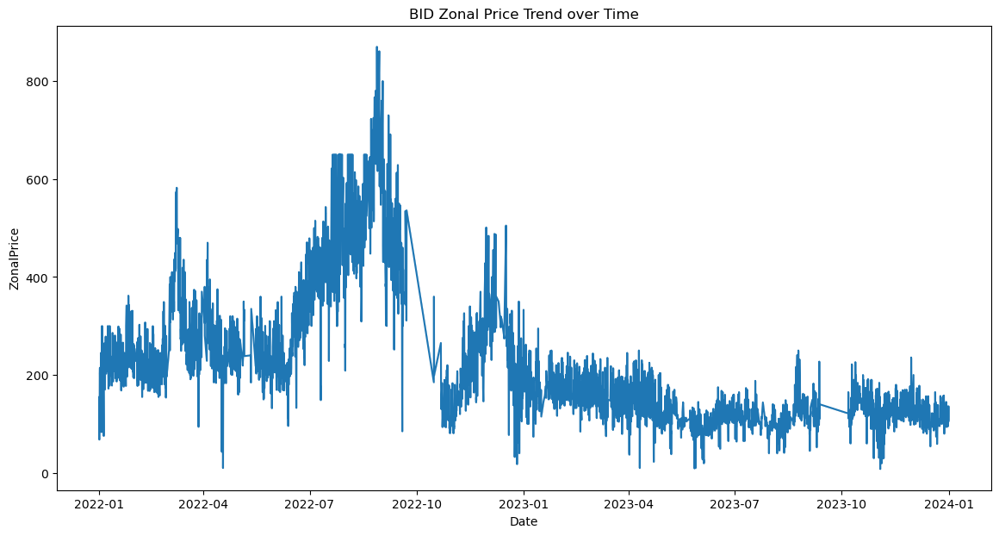

In [34]:
plt.figure(figsize=(14, 7))
sns.lineplot(x='Date', y='ZonalPrice', data=bid_df)
plt.title('BID Zonal Price Trend over Time')
plt.show()

In [35]:
# Extract hours and days of the week
bid_df['hour'] = bid_df['Date'].dt.hour
bid_df['day_week'] = bid_df['Date'].dt.dayofweek

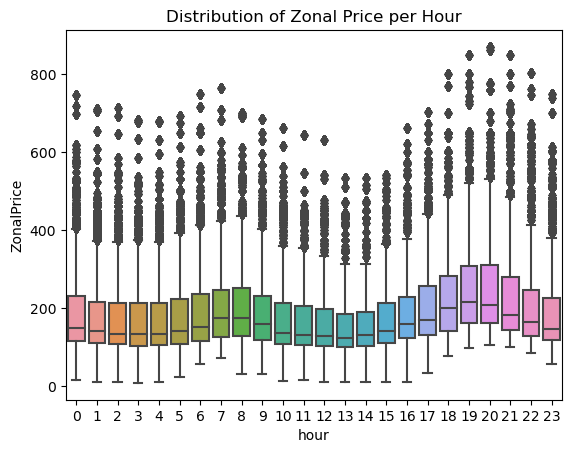

In [36]:
# Analysis for hours
sns.boxplot(x='hour', y='ZonalPrice', data=bid_df)
plt.title('Distribution of Zonal Price per Hour')
plt.show()

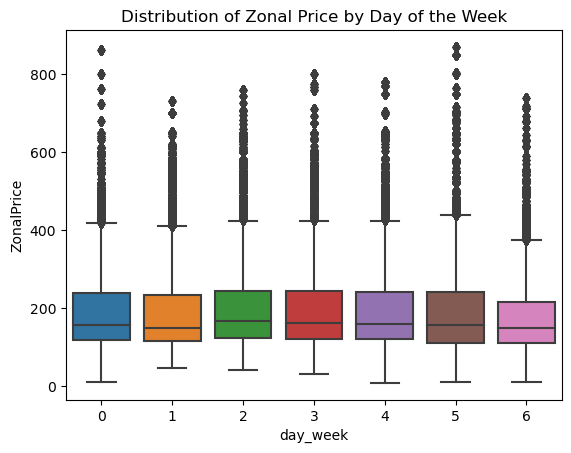

In [37]:
# Analysis by day of the week
sns.boxplot(x='day_week', y='ZonalPrice', data=bid_df)
plt.title('Distribution of Zonal Price by Day of the Week')
plt.show()

In [38]:
bid_df

,Date,ZonalPrice,Quantity,Price,Hour,DayOfYear,hour,day_week
2840,2022-01-01 07:00:00,99.99,18775.156,3000.00,7,1,7,5
2841,2022-01-01 07:00:00,99.99,7.114,2999.00,7,1,7,5
2842,2022-01-01 07:00:00,99.99,2.526,2000.00,7,1,7,5
2843,2022-01-01 07:00:00,99.99,162.000,1000.00,7,1,7,5
2844,2022-01-01 07:00:00,99.99,267.513,800.00,7,1,7,5
...,...,...,...,...,...,...,...,...
6153398,2023-12-31 23:00:00,106.12,0.007,0.00,23,365,23,6
6153399,2023-12-31 23:00:00,106.12,50.000,-0.27,23,365,23,6
6153400,2023-12-31 23:00:00,106.12,9.000,-3.01,23,365,23,6
6153401,2023-12-31 23:00:00,106.12,54.000,-100.00,23,365,23,6


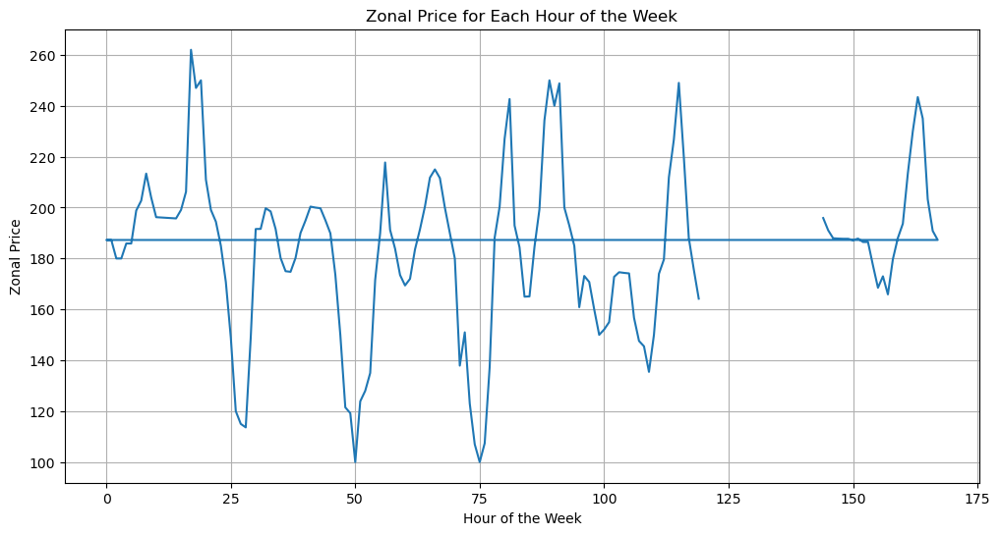

In [39]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Filter data for a single week
start_date = '2023-01-01'
end_date = '2023-01-07'
week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] < end_date)]

# Create a continuous function for zonal prices for each hour of the week
plt.figure(figsize=(12, 6))

# Plot zonal price against hours for the entire week
plt.plot(week_data['Hour'] + ((week_data['Date'].dt.dayofweek % 7) * 24), week_data['ZonalPrice'])

plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of the Week')

plt.grid(True)
plt.show()



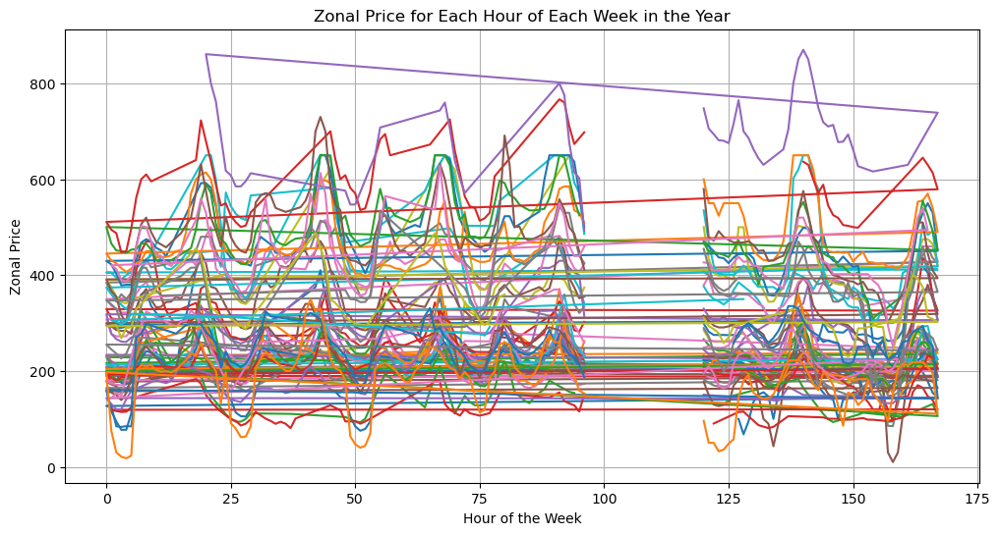

In [40]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Create an empty figure
plt.figure(figsize=(12, 6))

# Iterate over each week of the year
for week in range(1, 53):
    # Filter data for the current week
    start_date = pd.Timestamp(year=bid_df['Date'].iloc[0].year, month=1, day=1) + pd.DateOffset(weeks=(week - 1))
    end_date = start_date + pd.DateOffset(days=6)
    week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] <= end_date)]

    # Plot the zonal price against hours for the entire week
    plt.plot(week_data['Hour'] + ((week_data['Date'].dt.dayofweek % 7) * 24), week_data['ZonalPrice'], label=f'Week {week}')

# Add labels and title
plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of Each Week in the Year')


# Show grid
plt.grid(True)

# Show plot
plt.show()


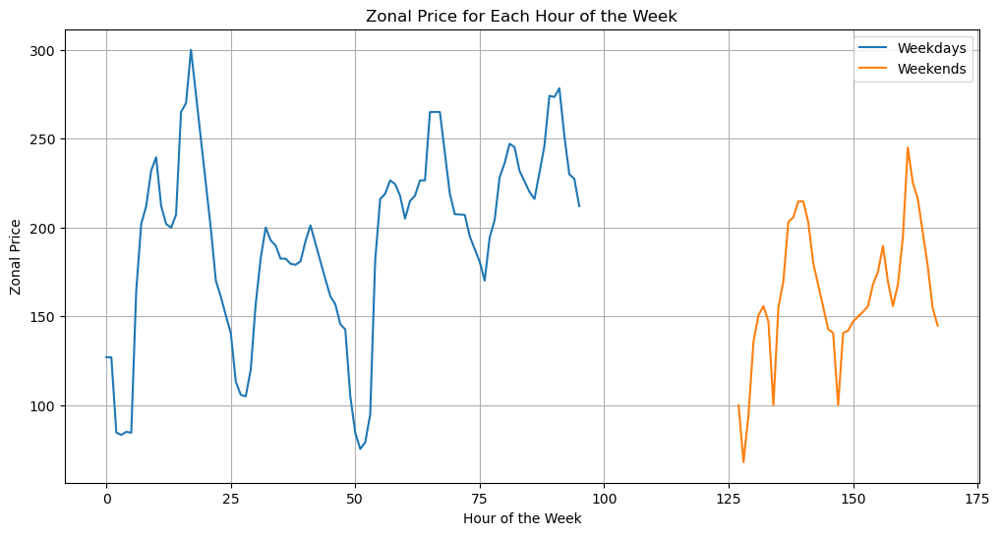

In [41]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Filter data for a single week
start_date = '2022-01-01'
end_date = '2022-01-07'
week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] < end_date)]

# Divide the week data into two parts: Monday to Friday and Saturday to Sunday
weekend_mask = (week_data['Date'].dt.dayofweek >= 5)  # Saturday and Sunday
weekday_mask = ~weekend_mask  # Monday to Friday

weekend_data = week_data[weekend_mask]
weekday_data = week_data[weekday_mask]

# Plot the zonal price against hours for each part of the week
plt.figure(figsize=(12, 6))

plt.plot(weekday_data['Hour'] + (weekday_data['Date'].dt.dayofweek * 24), weekday_data['ZonalPrice'], label='Weekdays')
plt.plot(weekend_data['Hour'] + (weekend_data['Date'].dt.dayofweek * 24), weekend_data['ZonalPrice'], label='Weekends')

plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of the Week')

plt.legend()
plt.grid(True)
plt.show()


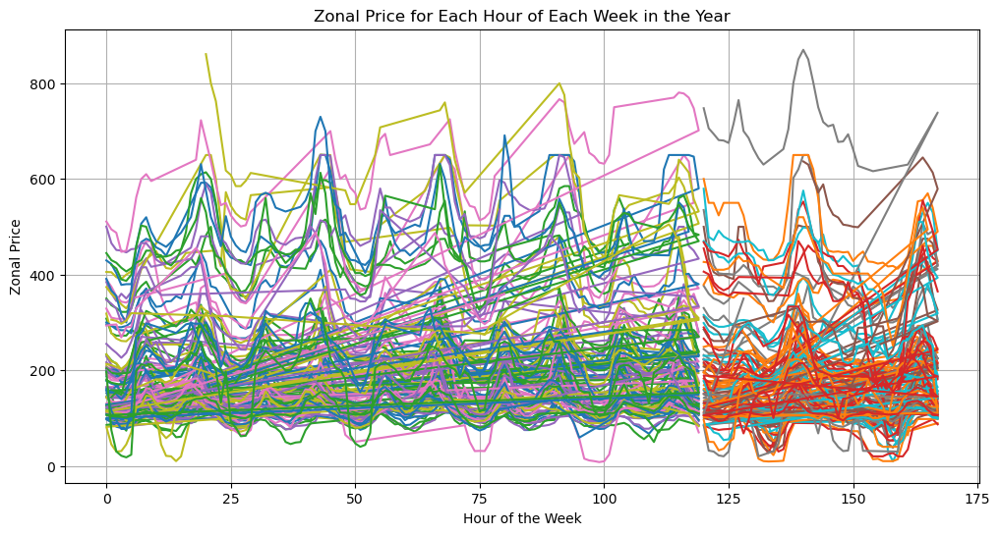

In [42]:
# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Create an empty figure
plt.figure(figsize=(12, 6))

# Iterate over each week of the year
for week in range(1, 53):
    # Filter data for the current week
    week_data = bid_df[bid_df['Date'].dt.isocalendar().week == week]

    # Divide the week data into two parts: Monday to Friday and Saturday to Sunday
    weekend_mask = (week_data['Date'].dt.dayofweek >= 5)  # Saturday and Sunday
    weekday_mask = ~weekend_mask  # Monday to Friday

    weekend_data = week_data[weekend_mask]
    weekday_data = week_data[weekday_mask]

    # Plot the zonal price against hours for each part of the week
    plt.plot(weekday_data['Hour'] + (weekday_data['Date'].dt.dayofweek * 24), weekday_data['ZonalPrice'], label=f'Week {week} - Weekdays')
    plt.plot(weekend_data['Hour'] + (weekend_data['Date'].dt.dayofweek * 24), weekend_data['ZonalPrice'], label=f'Week {week} - Weekends')

# Add labels and title
plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of Each Week in the Year')

# Show grid
plt.grid(True)

# Show plot
plt.show()


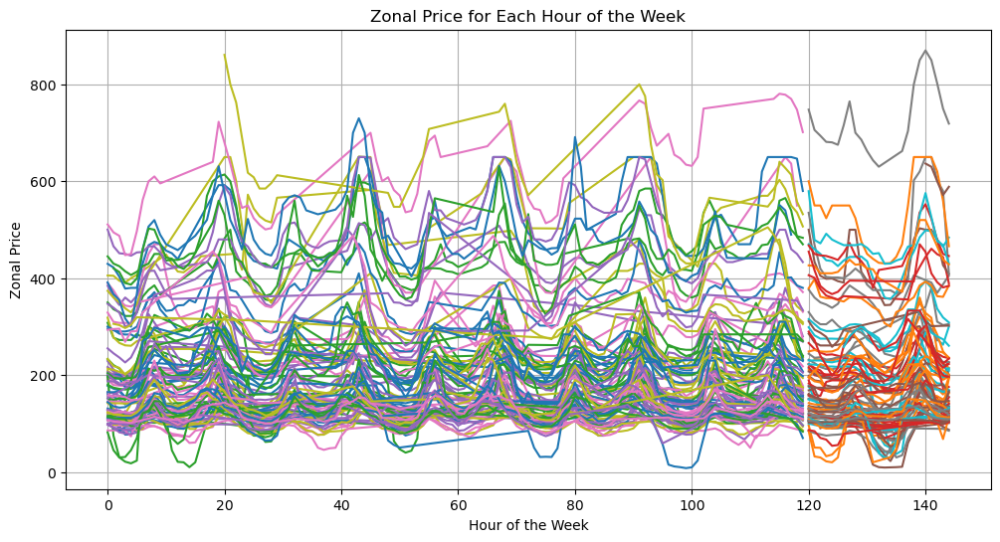

In [43]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Generate start dates for each week of the year
start_dates = pd.date_range(start='2022-01-01', end='2023-12-31', freq='W-MON')

plt.figure(figsize=(12, 6))

# Iterate over each week
for start_date in start_dates:
    end_date = start_date + pd.DateOffset(days=6)
    
    # Filter data for the current week
    week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] <= end_date)]
    
    # Divide the week data into two parts: Monday to Friday and Saturday to Sunday
    weekend_mask = (week_data['Date'].dt.dayofweek >= 5)  # Saturday and Sunday
    weekday_mask = ~weekend_mask  # Monday to Friday

    weekend_data = week_data[weekend_mask]
    weekday_data = week_data[weekday_mask]

    # Plot the zonal price against hours for each part of the week
    plt.plot(weekday_data['Hour'] + (weekday_data['Date'].dt.dayofweek * 24), weekday_data['ZonalPrice'], label='Weekdays')
    plt.plot(weekend_data['Hour'] + (weekend_data['Date'].dt.dayofweek * 24), weekend_data['ZonalPrice'], label='Weekends')

plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of the Week')

plt.grid(True)
plt.show()

curves for 2022 and 2023

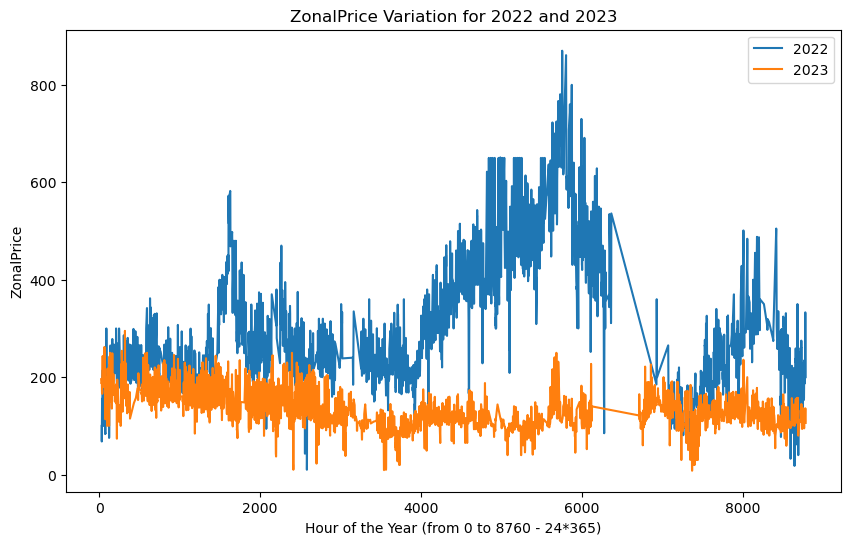

In [ ]:

# Extract year, hour, and ZonalPrice columns
bid_df['Year'] = bid_df['Date'].dt.year
bid_df['Hour_of_year'] = bid_df['Date'].dt.dayofyear * 24 + bid_df['Date'].dt.hour

# Filter data for years 2022 and 2023
data_2022 = bid_df[bid_df['Year'] == 2022]
data_2023 = bid_df[bid_df['Year'] == 2023]

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(data_2022['Hour_of_year'], data_2022['ZonalPrice'], label='2022')
plt.plot(data_2023['Hour_of_year'], data_2023['ZonalPrice'], label='2023')
plt.xlabel('Hour of the Year (from 0 to 8760 - 24*365)')
plt.ylabel('ZonalPrice')
plt.title('ZonalPrice Variation for 2022 and 2023')
plt.legend()

# Set limits for the x-axis
#plt.xlim(0, 24*365)

plt.show()




# FDA from R

## smoothing methods for months 

In [ ]:
#load bid_df
with open('bid_df.pickle', 'rb') as f:
    bid_df = pickle.load(f)

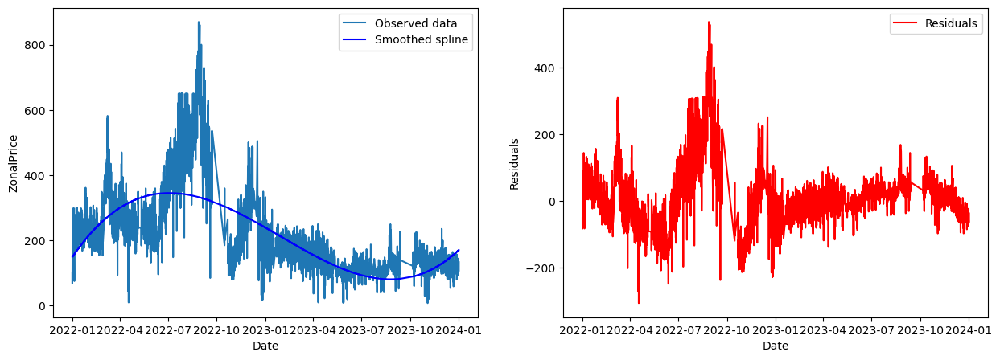

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pygam import LinearGAM, s

# Estrai le colonne che ti interessano
abscissa = pd.to_datetime(bid_df['Date'])
Xobs0 = bid_df['ZonalPrice']

# Calcola il numero di giorni trascorsi dalla data minima
abscissa_days = (abscissa - abscissa.min()).dt.days

# Definisci il numero di nodi per la spline cubica
m = 4

# Crea la matrice dei nodi
breaks = np.linspace(abscissa_days.min(), abscissa_days.max(), m)

# Definisci il modello di smoothing spline
gam = LinearGAM(s(0, n_splines=m)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)

# Valuta il modello
Xss0 = gam.predict(abscissa_days)

# Plot dei risultati
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(abscissa, Xobs0, label='Observed data')
plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.legend()

plt.show()



In [ ]:
## change lambda: 1e-5
gam = LinearGAM(s(0, n_splines=m, lam=1e-5)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0 = gam.predict(abscissa_days)


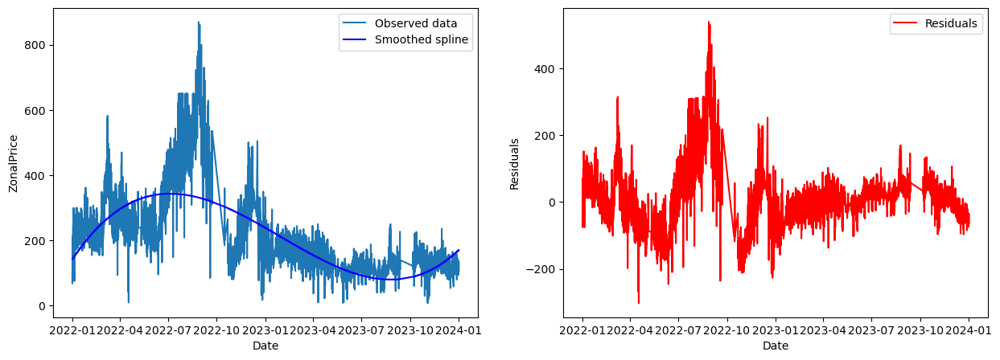

In [ ]:
#plot results with this lambda as before
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(abscissa, Xobs0, label='Observed data')
plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.legend()

plt.show()

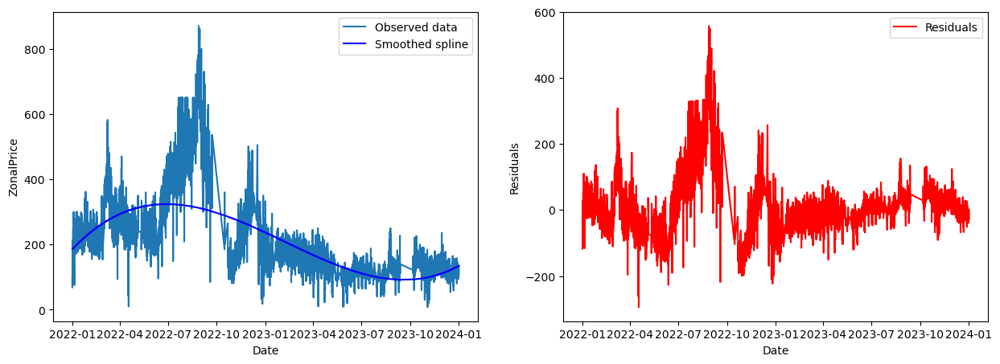

In [ ]:
# change lambda: 1e-12
gam = LinearGAM(s(0, n_splines=m, lam=1e-12)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0 = gam.predict(abscissa_days)

#plot results with this lambda as before
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(abscissa, Xobs0, label='Observed data')
plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.legend()

plt.show()

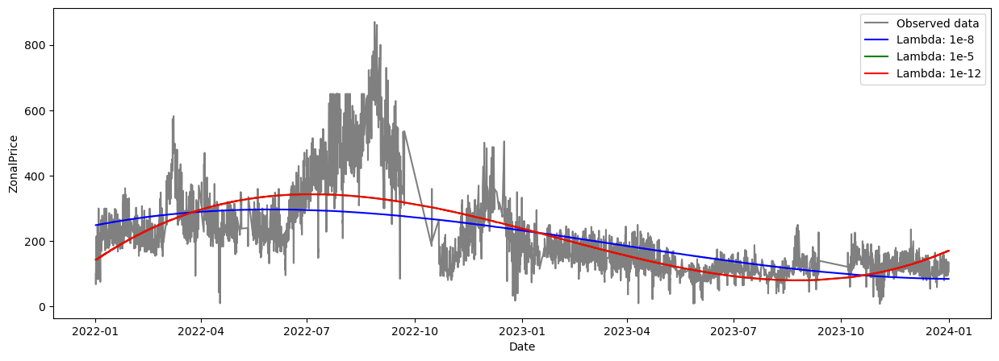

In [ ]:
from pygam import LinearGAM, s

# Estrai le colonne che ti interessano
abscissa = pd.to_datetime(bid_df['Date'])
Xobs0 = bid_df['ZonalPrice']

# Calcola il numero di giorni trascorsi dalla data minima
abscissa_days = (abscissa - abscissa.min()).dt.days

# Definisci il numero di nodi per la spline cubica
m = 4

# Crea la matrice dei nodi
breaks = np.linspace(abscissa_days.min(), abscissa_days.max(), m)

# Definisci il modello di smoothing spline con lambda: 1e-8
gam_lambda_8 = LinearGAM(s(0, n_splines=m)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)

# Valuta il modello con lambda: 1e-8
Xss0_lambda_8 = gam_lambda_8.predict(abscissa_days)

# Cambia lambda: 1e-5
gam_lambda_5 = LinearGAM(s(0, n_splines=m, lam=1e-10)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0_lambda_5 = gam_lambda_5.predict(abscissa_days)

# Cambia lambda: 1e-12
gam_lambda_12 = LinearGAM(s(0, n_splines=m, lam=1e-12)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0_lambda_12 = gam_lambda_12.predict(abscissa_days)

# Plot dei risultati
plt.figure(figsize=(15, 5))

plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_8, label='Lambda: 1e-8', color='blue')
plt.plot(abscissa, Xss0_lambda_5, label='Lambda: 1e-5', color='green')
plt.plot(abscissa, Xss0_lambda_12, label='Lambda: 1e-12', color='red')

plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.show()


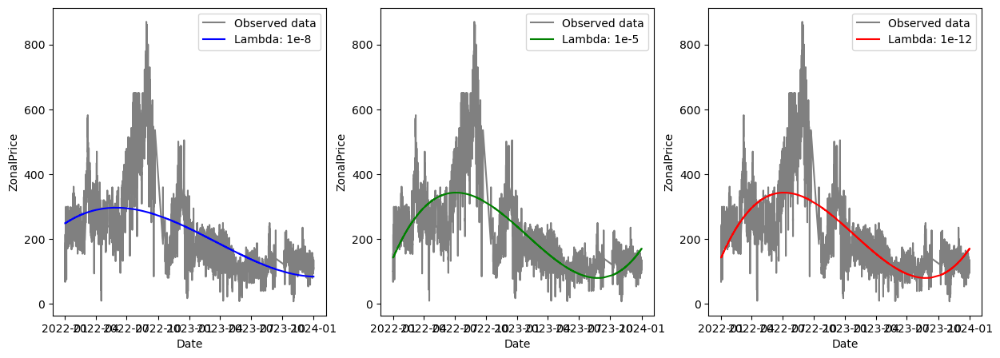

In [ ]:
#sulla stessa riga un plot per ogni lambda
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_8, label='Lambda: 1e-8', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 3, 2)
plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_5, label='Lambda: 1e-5', color='green')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 3, 3)
plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_12, label='Lambda: 1e-12', color='red')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.show()

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pygam import LinearGAM, s

# Convert the 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract the time of day and the day from the 'Date' column
bid_df['Time'] = bid_df['Date'].dt.time
bid_df['Day'] = bid_df['Date'].dt.date

# Extract unique days
unique_days = bid_df['Day'].unique()

# Define the number of splines for smoothing
m = 4

plt.figure(figsize=(15, 5 * len(unique_days)))

# Iterate through each unique day
for i, day in enumerate(unique_days):
    day_data = bid_df[bid_df['Day'] == day]
    abscissa = day_data['Time']
    Xobs0 = day_data['ZonalPrice']

    # Convert time to seconds since midnight for fitting the model
    abscissa_seconds = day_data['Date'].dt.hour * 3600 + day_data['Date'].dt.minute * 60 + day_data['Date'].dt.second

    # Fit the smoothing spline model
    gam = LinearGAM(s(0, n_splines=m)).fit(abscissa_seconds.values.reshape(-1, 1), Xobs0)

    # Evaluate the model
    Xss0 = gam.predict(abscissa_seconds)

    # Plot the observed data and the smoothed spline
    plt.subplot(len(unique_days), 2, 2 * i + 1)
    plt.plot(abscissa, Xobs0, label='Observed data')
    plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
    plt.xlabel('Time')
    plt.ylabel('ZonalPrice')
    plt.title(f'Zonal Price on {day}')
    plt.legend()

    # Plot the residuals
    plt.subplot(len(unique_days), 2, 2 * i + 2)
    plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
    plt.xlabel('Time')
    plt.ylabel('Residuals')
    plt.title(f'Residuals on {day}')
    plt.legend()

plt.tight_layout()
plt.show()


# smoothing for daily zonal prices

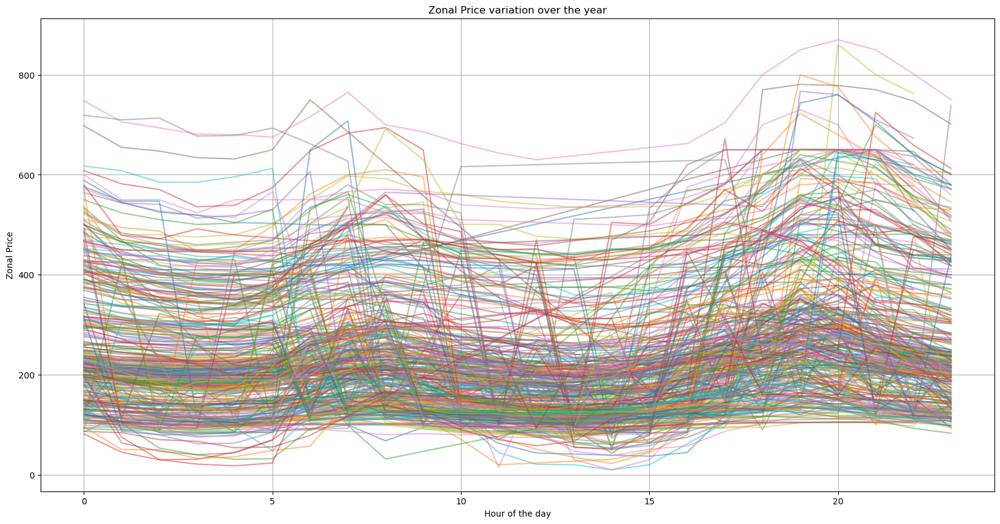

In [61]:
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Remove duplicate 'Hour' values within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

plt.figure(figsize=(20, 10))

for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    plt.plot(daily_data['Hour'], daily_data['ZonalPrice'], label=f'Day {day}', alpha=0.5)

plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Zonal Price variation over the year')
plt.grid(True)
plt.show()


## constrain the function to be positive 

 for all the function

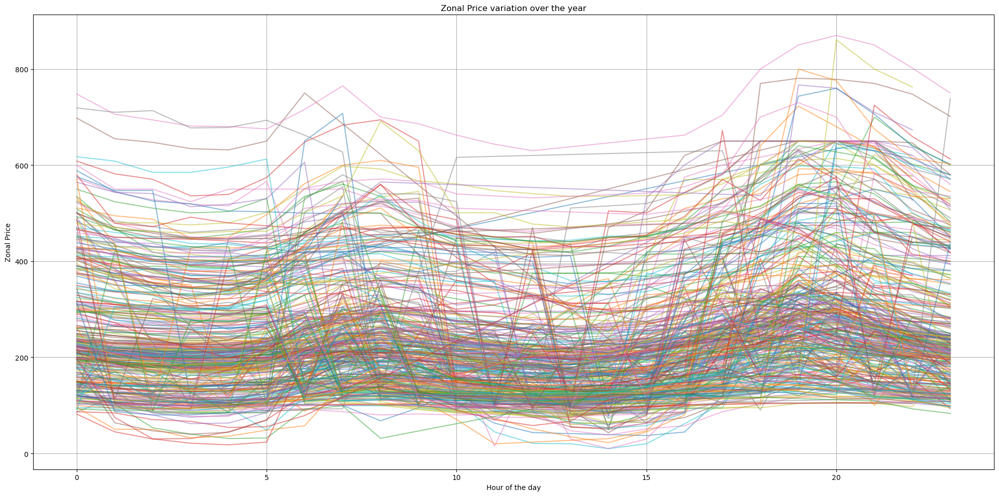

In [60]:
# Import libraries
from scipy.interpolate import UnivariateSpline


# Extract hour and day of year
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove duplicate 'Hour' values within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Plot settings
plt.figure(figsize=(20, 10))

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply logarithmic transformation for positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create spline of transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Plot smoothed data
    plt.plot(daily_data['Hour'], smoothed_price, label=f'Day {day}', alpha=0.5)

# Customize plot
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Zonal Price variation over the year')
plt.grid(True)
plt.tight_layout()  

# Show the plot
plt.show()


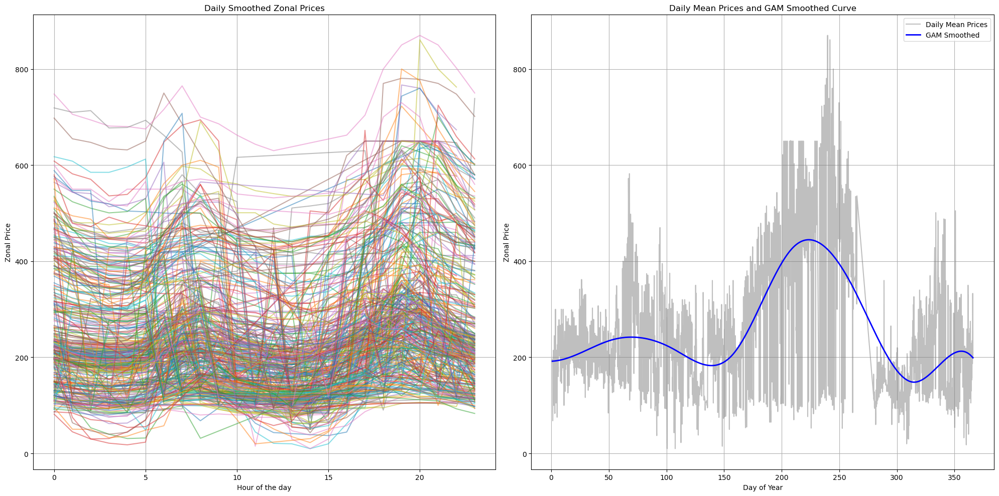

In [66]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Collect smoothed prices for each day
smoothed_prices = []

for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)  # Add 1 to avoid log(0)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    daily_smoothed_data = daily_data.copy()
    daily_smoothed_data['SmoothedPrice'] = smoothed_price
    smoothed_prices.append(daily_smoothed_data)

# Concatenate all daily smoothed data into a single DataFrame
smoothed_bid_df = pd.concat(smoothed_prices)

# Prepare data for GAM smoothing
daily_means = smoothed_bid_df.groupby(['DayOfYear', 'Hour'])['SmoothedPrice'].mean().reset_index()

# Extract columns
abscissa = daily_means['DayOfYear'] + daily_means['Hour'] / 24.0  # Convert to a continuous variable
Xobs0 = daily_means['SmoothedPrice']

# Define the number of knots for the cubic spline
m = 10  # Adjust the number of knots as needed

# Define the smoothing spline model
gam = LinearGAM(s(0, n_splines=m)).fit(abscissa.values.reshape(-1, 1), Xobs0)

# Evaluate the model
Xss0 = gam.predict(abscissa)

# Plot the results
plt.figure(figsize=(20, 10))

# Plot smoothed prices for each day
plt.subplot(1, 2, 1)
for day in bid_df['DayOfYear'].unique():
    daily_data = smoothed_bid_df[smoothed_bid_df['DayOfYear'] == day]
    plt.plot(daily_data['Hour'], daily_data['SmoothedPrice'], label=f'Day {day}', alpha=0.5)
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Daily Smoothed Zonal Prices')
plt.grid(True)
plt.tight_layout()

# Plot daily mean prices and GAM smoothed curve
plt.subplot(1, 2, 2)
plt.plot(daily_means['DayOfYear'] + daily_means['Hour'] / 24.0, Xobs0, label='Daily Mean Prices', color='gray', alpha=0.5)
plt.plot(daily_means['DayOfYear'] + daily_means['Hour'] / 24.0, Xss0, label='GAM Smoothed', color='blue', linewidth=2)
plt.xlabel('Day of Year')
plt.ylabel('Zonal Price')
plt.title('Daily Mean Prices and GAM Smoothed Curve')
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()


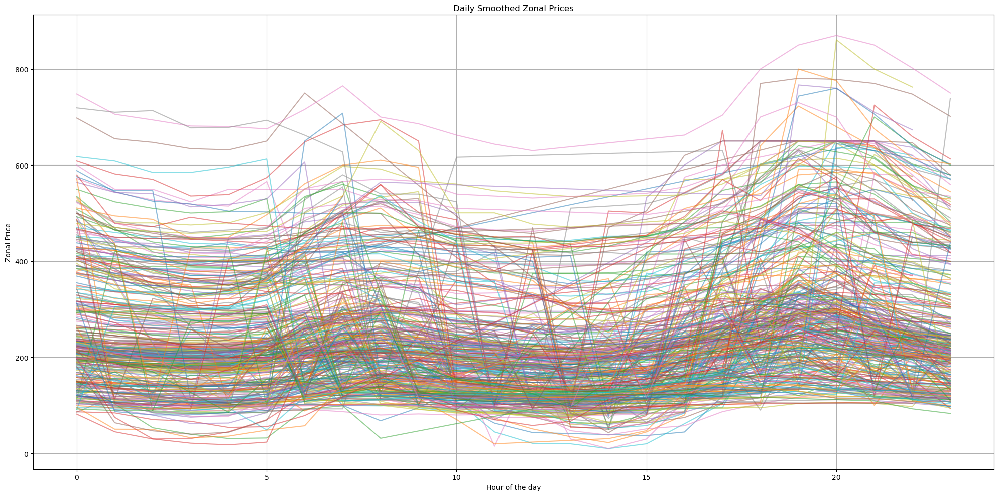

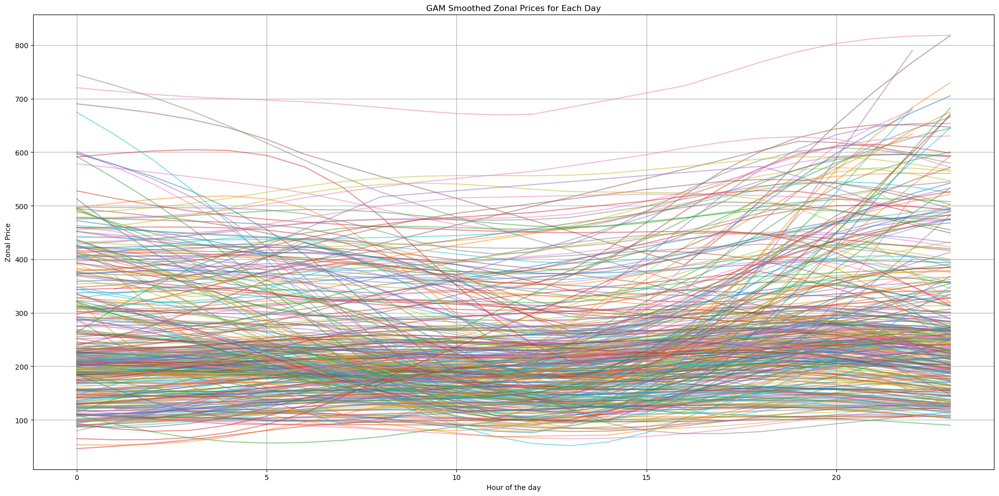

In [69]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

plt.figure(figsize=(20, 10))

# Collect smoothed prices for each day
all_smoothed_prices = []

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Store the smoothed prices
    all_smoothed_prices.append((daily_data['Hour'].values, smoothed_price))
    
    # Plot smoothed data for each day
    plt.plot(daily_data['Hour'], smoothed_price, alpha=0.5, label=f'Day {day}')

# Customize plot
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Daily Smoothed Zonal Prices')
plt.grid(True)
plt.tight_layout()  
plt.show()

# Apply GAM smoothing to each day's smoothed prices
plt.figure(figsize=(20, 10))
for hours, smoothed_prices in all_smoothed_prices:
    hours = hours.reshape(-1, 1)  # Convert to 2D array for GAM
    gam = LinearGAM(s(0, n_splines=10)).fit(hours, smoothed_prices)
    gam_smoothed_prices = gam.predict(hours)
    plt.plot(hours, gam_smoothed_prices, alpha=0.5)

# Customize plot for GAM smoothed prices
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('GAM Smoothed Zonal Prices for Each Day')
plt.grid(True)
plt.tight_layout()  
plt.show()


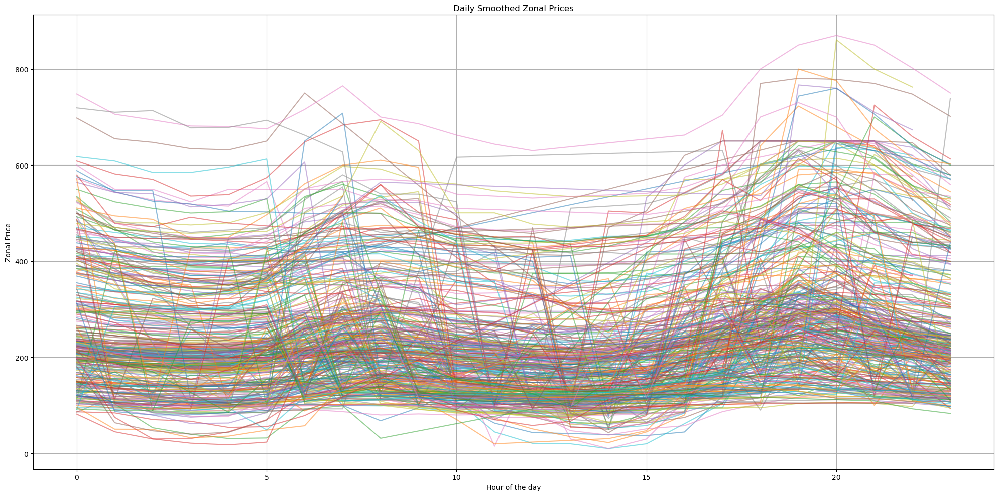

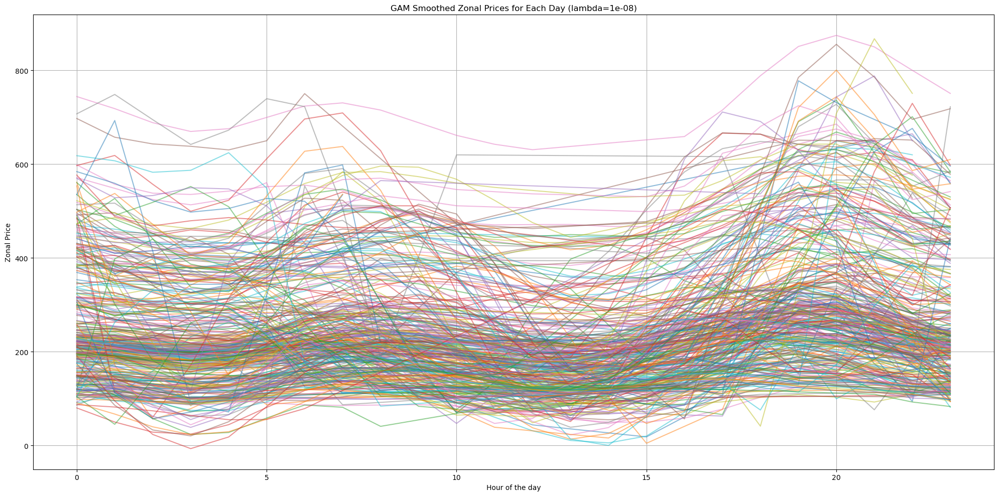

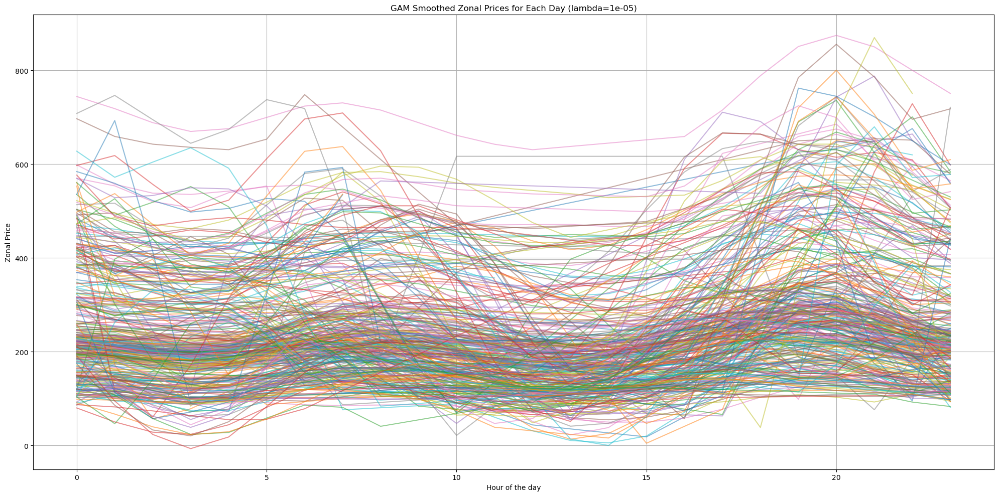

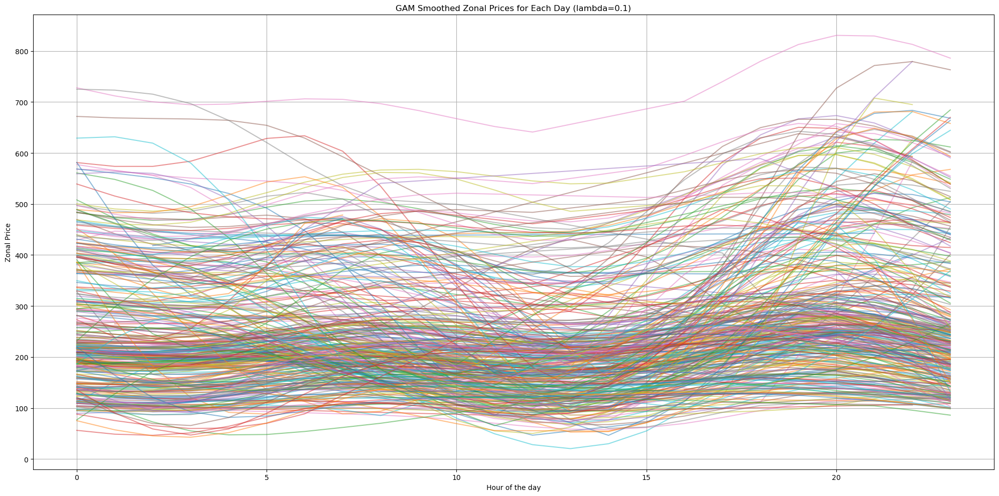

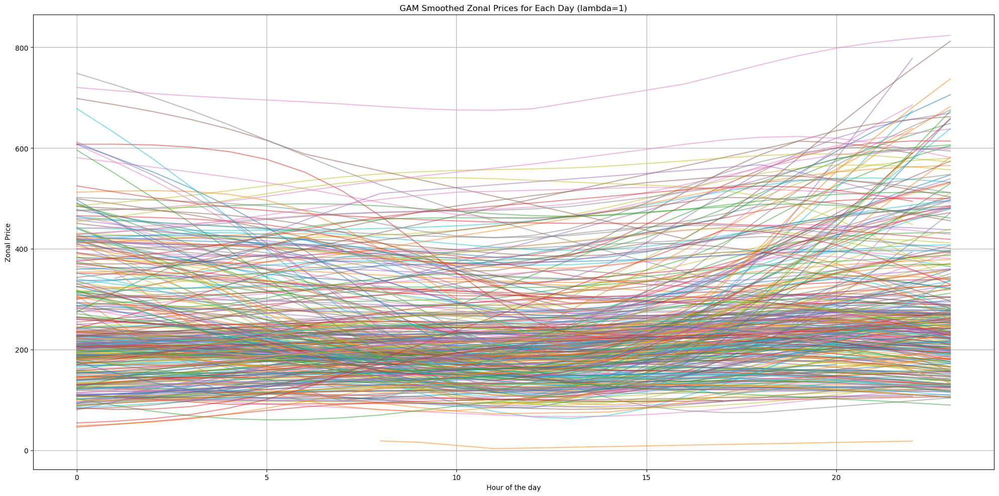

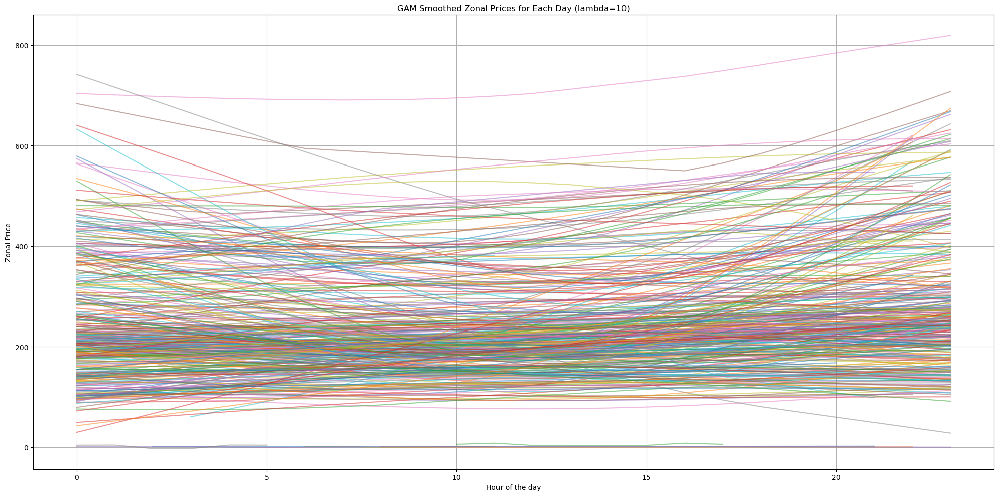

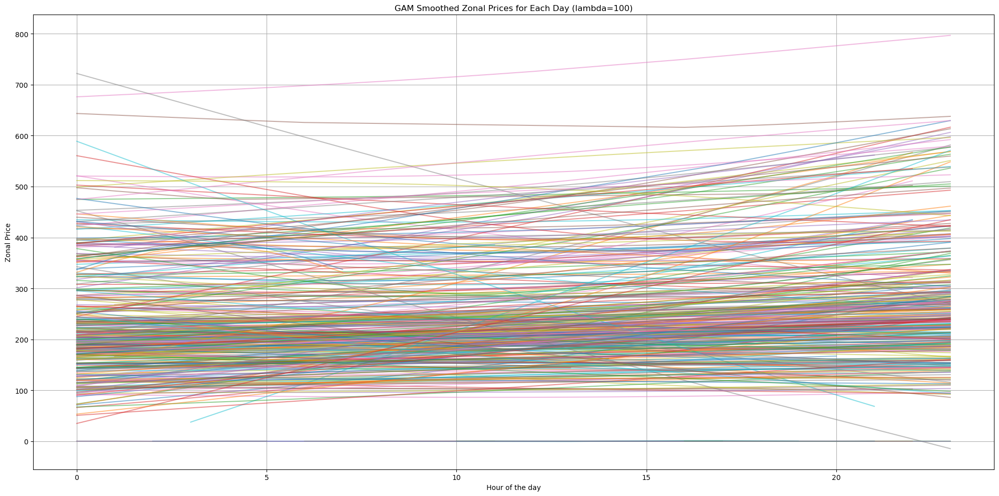

In [71]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

plt.figure(figsize=(20, 10))

# Collect smoothed prices for each day
all_smoothed_prices = []

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Store the smoothed prices
    all_smoothed_prices.append((daily_data['Hour'].values, smoothed_price))
    
    # Plot smoothed data for each day
    plt.plot(daily_data['Hour'], smoothed_price, alpha=0.5, label=f'Day {day}')

# Customize plot
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Daily Smoothed Zonal Prices')
plt.grid(True)
plt.tight_layout()  
plt.show()

# Lambda values to test
lambdas = [1e-8,1e-5,0.1, 1, 10, 100]

# Apply GAM smoothing to each day's smoothed prices for each lambda value
for lam in lambdas:
    plt.figure(figsize=(20, 10))
    for hours, smoothed_prices in all_smoothed_prices:
        hours = hours.reshape(-1, 1)  # Convert to 2D array for GAM
        gam = LinearGAM(s(0, n_splines=10, lam=lam)).fit(hours, smoothed_prices)
        gam_smoothed_prices = gam.predict(hours)
        plt.plot(hours, gam_smoothed_prices, alpha=0.5)

    # Customize plot for GAM smoothed prices
    plt.xlabel('Hour of the day')
    plt.ylabel('Zonal Price')
    plt.title(f'GAM Smoothed Zonal Prices for Each Day (lambda={lam})')
    plt.grid(True)
    plt.tight_layout()  
    plt.show()


# K Means 